In [46]:
from models import LightningRegression,LightningVersatile,create_model, get_model_from_exp
from model_info import encoders, modulators, model_output_dims, BigDecoder, BigMultiHeadClassifier
from utils import set_seed, get_args
import torch
import pandas as pd
from tqdm.notebook import tqdm
from torch.utils.data import TensorDataset
import torch.nn as nn
import torch.nn.functional as F
import torch
import torchvision.transforms.functional as TF
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.lines import Line2D

def plot_images(
    images,
    ncols=8,
    normalize=True,
    title=None,
    highlight_idx=None,
    highlight_color='red',
    linewidth=3,
    vline_before_idx=None,
    vline_color='blue',
    save=False,
    save_name="image.g"

):
    B, C, H, W = images.shape
    nrows = (B + ncols - 1) // ncols
    fig, axs = plt.subplots(nrows, ncols, figsize=(ncols * 2, nrows * 2))
    axs = axs.flatten()

    for i, ax in enumerate(axs):
        ax.axis('off')
        if i < B:
            img = images[i]
            if normalize:
                img = (img - img.min()) / (img.max() - img.min() + 1e-5)
            if C == 1:
                ax.imshow(img.squeeze().cpu().numpy(), cmap='gray')
            else:
                ax.imshow(img.permute(1, 2, 0).cpu().numpy())

            if highlight_idx is not None and i == highlight_idx:
                ax.add_patch(patches.Rectangle(
                    (0, 0), 1, 1,
                    transform=ax.transAxes,
                    fill=False,
                    edgecolor=highlight_color,
                    linewidth=linewidth
                ))
        else:
            ax.set_visible(False)

    if title:
        plt.suptitle(title, fontsize=16)
        plt.subplots_adjust(top=0.92)

    plt.tight_layout()  # Adjust layout first

    # Add vertical line after layout is finalized
    if vline_before_idx is not None and 0 <= vline_before_idx < B:
        row = vline_before_idx // ncols
        col = vline_before_idx % ncols
        ax = axs[row * ncols + col]
        bbox = ax.get_position()
        x = bbox.x0
        line = Line2D([x, x], [0, 1], transform=fig.transFigure, color=vline_color, linewidth=2)
        fig.add_artist(line)

    if save:
        fig.savefig(save_name, dpi=300, bbox_inches='tight')
    plt.show()

    
def get_reps_from_model(exp_id):
    
    args = get_args(exp_id,update_id=True)
    args.encoder['pretrain_method'] = None
    model = get_model_from_exp(args)
    # Data loader is simply a TensorDataset of 
    dl = get_dataloader(args)
    # create reps for full dataset for training autoencoder
    reps = get_reps(args, model, dl)
    return reps

def get_reps(args, model, dl):
    reps = []
    model.eval()
    with torch.no_grad():
        for img, rep, latents in tqdm(dl):
            bs = rep.shape[0]
            rep = rep.float().cuda()

            delta = torch.zeros(bs, len(args.FOVS_PER_DATASET)).cuda()
            new_rep = model.modulator(rep, delta)
            reps.append(new_rep.cpu())
        return torch.cat(reps, dim=0)

def get_dataloader(args, indices = [], bs=1024, shuffle=False):
    
    data = torch.load(f"{args.dataset}/{args.dataset}.pth", map_location="cpu")
    reps_path = None
    if args.pretrained_reps:
        reps_path = args.pretrained_reps
    elif args.pretrained_encoder:
        encoder_args = get_args(args.pretrained_encoder)
        reps_path = encoder_args.pretrained_reps
    have_reps = reps_path is not None
    if have_reps:
        print("using pretrained reps...")
        data['reps'] = torch.load(f"{args.dataset}/{args.dataset}_images_feats_{reps_path}.pth", map_location="cpu") if reps_path else None
        data['reps'] = data['reps'] - data['reps'].mean(dim=0) # center
        data['reps'] = torch.nn.functional.normalize(data['reps'], p=2.0, dim=1, eps=1e-12)
    else:
        print("using input images")
    if indices == []:
        indices = torch.tensor([i for i in range(data['images'].shape[0])])
    ds = TensorDataset(
                data['images'][indices],
                data['reps'][indices] if have_reps else data['latents'][indices],
                data['latent_ids'][indices]
                )
    dl = torch.utils.data.DataLoader(ds, batch_size=bs, shuffle=shuffle)
    return dl

def train_step(model,
               optimizer,
               batch,
               device,
               process_input,
               oracle_input,
               variational,
               kld_weight,
               cross_entropy=False):
    model.train()

    data, labels = batch

    data = data.to(device)
    labels = labels.to(device)

    if process_input:
        x, y = process_input(data)
    else:
        x = data
        y = labels

    optimizer.zero_grad(set_to_none=True)
    if oracle_input == False:
        output = model(x)
    else:
        output = model(x, labels)

    if variational:
        recons, mu, log_var = output
        loss, recons_loss, kld_loss = model.loss_function(y, recons, mu, log_var, kld_weight=kld_weight)
    elif cross_entropy:
        loss = F.cross_entropy(output, (y*255).squeeze(1).long())
    else:
        loss = F.mse_loss(output, y)

    loss.backward()
    optimizer.step()

    if variational:
        return loss, recons_loss, kld_loss

    return loss

def train_autoencoder_generative(model,
                                 dataloader,
                                 optimizer,
                                 device,
                                 epoch,
                                 variational=False,
                                 test_every=0,
                                 test_fn=None,
                                 oracle_input=False,
                                 process_input=None,
                                 kld_weight=0.1,
                                 cross_entropy=False):

    train_loss = 0
    cum_recons_loss = cum_kld_loss = 0
    all_training_losses = []
    for batch_idx, batch in enumerate(dataloader):
        data, labels = batch
        loss = train_step(model,
                          optimizer,
                          batch,
                          device,
                          process_input,
                          oracle_input,
                          variational,
                          kld_weight,
                          cross_entropy=cross_entropy)

        if variational:
            loss, recons_loss, kld_loss = loss
            cum_recons_loss += recons_loss.item()
            cum_kld_loss += kld_loss.item()

        last_loss = loss.item()
        train_loss += last_loss

        all_training_losses.append(last_loss)

        if batch_idx % 187 == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, batch_idx * len(data), len(dataloader.dataset),
                100. * batch_idx / len(dataloader), loss.item()))

        current_iter = batch_idx + epoch*len(dataloader)
        if test_every > 0 and current_iter % test_every == 0:
            test_fn(model, current_iter)

    if variational:
        train_loss /= len(dataloader) # loss function already averages over batch size, now average across batches.
        cum_recons_loss /= len(dataloader) # loss function already averages over batch size, now average across batches.
        cum_kld_loss /= len(dataloader) # loss function already averages over batch size, now average across batches.
        print('====> Epoch: {} Average loss: {:.4f} (RECON: {:.4f} + KLD: {:.4f})'
              .format(epoch, train_loss, cum_recons_loss, cum_kld_loss) )
        return (train_loss, cum_recons_loss, cum_kld_loss), all_training_losses
    else:
        train_loss /= len(dataloader) # loss function already averages over batch size, now average across batches.
        print('====> Epoch: {} Average loss: {:.4f}'.format(
            epoch, train_loss) )
        return train_loss, all_training_losses
# Evaluation

In [114]:
# load model

exp_id = "e99wn9i9"
reps = get_reps_from_model(exp_id)

using pretrained reps...


100%|██████████| 469/469 [00:12<00:00, 36.30it/s]


In [20]:
from torch.utils.data import DataLoader
reps_path = None
exp_id = "e99wn9i9"
args = get_args(exp_id)
if args.pretrained_reps:
    reps_path = args.pretrained_reps
elif args.pretrained_encoder:
    encoder_args = get_args(args.pretrained_encoder)
    reps_path = encoder_args.pretrained_reps
have_reps = reps_path is not None
data =  torch.load("3dshapes/3dshapes.pth")
imgs=data['images']/255.0
latents = data['latent_ids']
print("using pretrained reps...")
enc_reps= torch.load(f"{args.dataset}/{args.dataset}_images_feats_{reps_path}.pth", map_location="cpu") if reps_path else None
enc_reps = enc_reps - enc_reps.mean(dim=0) # center
enc_reps = torch.nn.functional.normalize(enc_reps, p=2.0, dim=1, eps=1e-12)

using pretrained reps...


In [ ]:
decoder

In [22]:
# create dataloader for decoder
decoder_dl = TensorDataset(enc_reps, imgs) # Use reps to train from reps of model, enc_reps from pretrained vit
decoder_dl = DataLoader(decoder_dl, batch_size=256, shuffle=True)

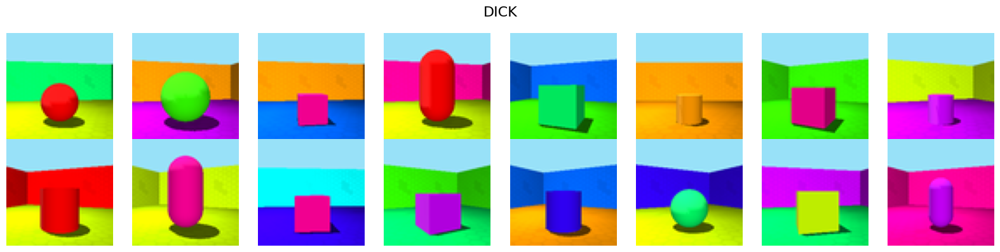

In [25]:
# Sample 5 unique integers from 0 to 99
tst_indices = random.sample(range(480000), 16)
tst_imgs = imgs[tst_indices]
plot_images(tst_imgs, title="DICK")

  0%|          | 0/10 [00:00<?, ?it/s]

Train Epoch: 0 [0/480000 (0%)]	Loss: 0.680443
Train Epoch: 0 [47872/480000 (10%)]	Loss: 0.011817
Train Epoch: 0 [95744/480000 (20%)]	Loss: 0.005345
Train Epoch: 0 [143616/480000 (30%)]	Loss: 0.003928
Train Epoch: 0 [191488/480000 (40%)]	Loss: 0.003225
Train Epoch: 0 [239360/480000 (50%)]	Loss: 0.003478
Train Epoch: 0 [287232/480000 (60%)]	Loss: 0.003417
Train Epoch: 0 [335104/480000 (70%)]	Loss: 0.002130
Train Epoch: 0 [382976/480000 (80%)]	Loss: 0.002035
Train Epoch: 0 [430848/480000 (90%)]	Loss: 0.001721
Train Epoch: 0 [478720/480000 (100%)]	Loss: 0.001546
====> Epoch: 0 Average loss: 0.0108


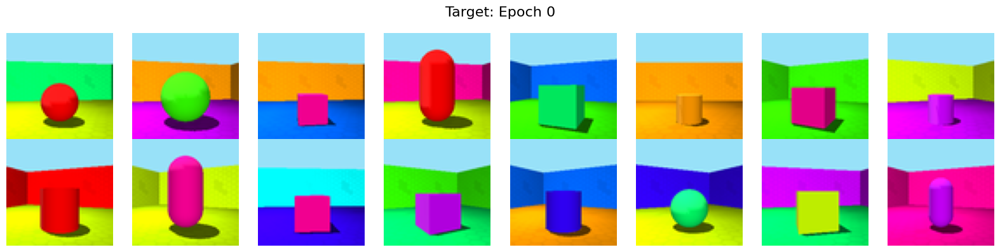

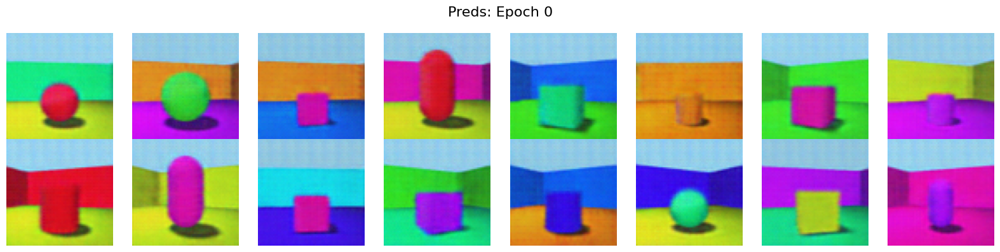

Train Epoch: 1 [0/480000 (0%)]	Loss: 0.001847
Train Epoch: 1 [47872/480000 (10%)]	Loss: 0.001757
Train Epoch: 1 [95744/480000 (20%)]	Loss: 0.001849
Train Epoch: 1 [143616/480000 (30%)]	Loss: 0.001383
Train Epoch: 1 [191488/480000 (40%)]	Loss: 0.001468
Train Epoch: 1 [239360/480000 (50%)]	Loss: 0.001415
Train Epoch: 1 [287232/480000 (60%)]	Loss: 0.001384
Train Epoch: 1 [335104/480000 (70%)]	Loss: 0.001144
Train Epoch: 1 [430848/480000 (90%)]	Loss: 0.000987
Train Epoch: 1 [478720/480000 (100%)]	Loss: 0.000943
====> Epoch: 1 Average loss: 0.0014


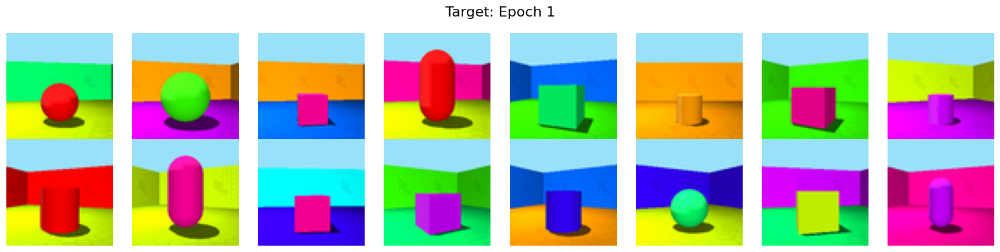

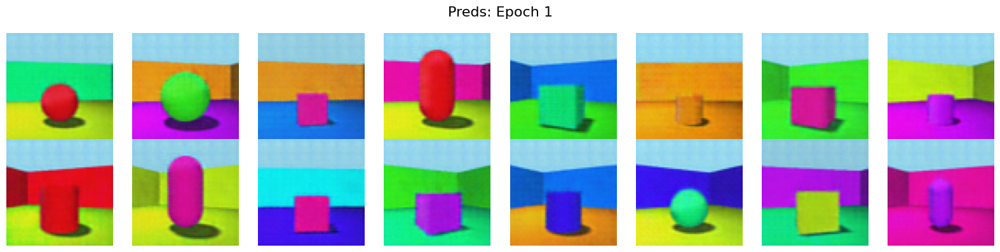

Train Epoch: 2 [0/480000 (0%)]	Loss: 0.000947
Train Epoch: 2 [47872/480000 (10%)]	Loss: 0.001051
Train Epoch: 2 [95744/480000 (20%)]	Loss: 0.001207
Train Epoch: 2 [143616/480000 (30%)]	Loss: 0.000933
Train Epoch: 2 [191488/480000 (40%)]	Loss: 0.001089
Train Epoch: 2 [239360/480000 (50%)]	Loss: 0.001201
Train Epoch: 2 [287232/480000 (60%)]	Loss: 0.001028
Train Epoch: 2 [335104/480000 (70%)]	Loss: 0.000819
Train Epoch: 2 [382976/480000 (80%)]	Loss: 0.000729
Train Epoch: 2 [430848/480000 (90%)]	Loss: 0.000692
Train Epoch: 2 [478720/480000 (100%)]	Loss: 0.001022
====> Epoch: 2 Average loss: 0.0009


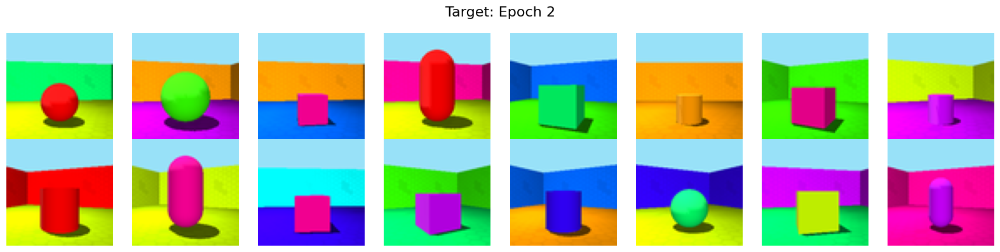

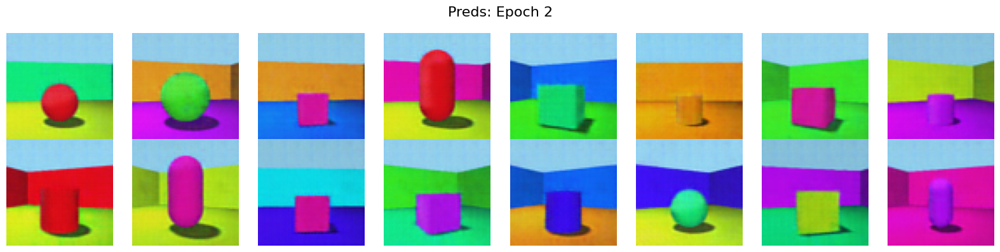

Train Epoch: 3 [0/480000 (0%)]	Loss: 0.001065
Train Epoch: 3 [47872/480000 (10%)]	Loss: 0.000707
Train Epoch: 3 [95744/480000 (20%)]	Loss: 0.000542
Train Epoch: 3 [143616/480000 (30%)]	Loss: 0.000511
Train Epoch: 3 [191488/480000 (40%)]	Loss: 0.000674
Train Epoch: 3 [239360/480000 (50%)]	Loss: 0.000590
Train Epoch: 3 [287232/480000 (60%)]	Loss: 0.000601
Train Epoch: 3 [335104/480000 (70%)]	Loss: 0.000650
Train Epoch: 3 [382976/480000 (80%)]	Loss: 0.000536
Train Epoch: 3 [430848/480000 (90%)]	Loss: 0.000461
Train Epoch: 3 [478720/480000 (100%)]	Loss: 0.000806
====> Epoch: 3 Average loss: 0.0006


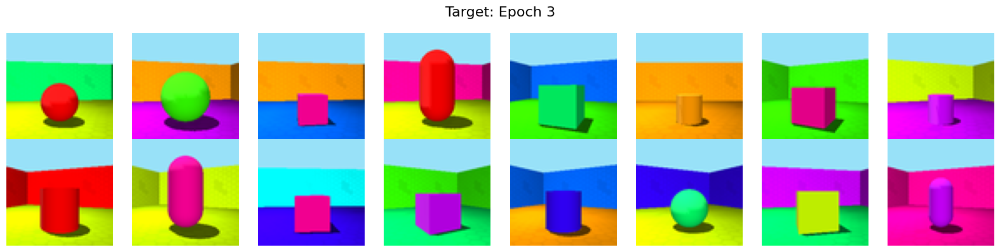

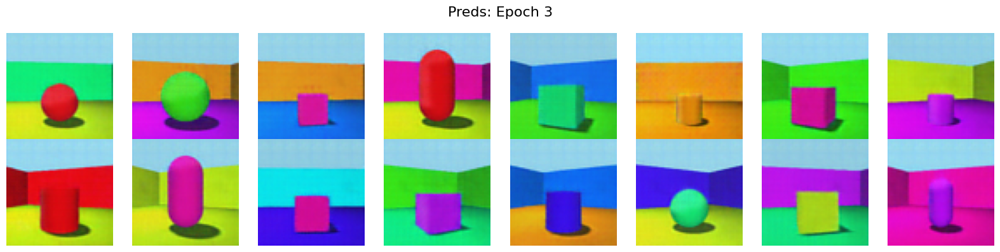

Train Epoch: 4 [0/480000 (0%)]	Loss: 0.000643
Train Epoch: 4 [47872/480000 (10%)]	Loss: 0.000401
Train Epoch: 4 [95744/480000 (20%)]	Loss: 0.000447
Train Epoch: 4 [143616/480000 (30%)]	Loss: 0.000368
Train Epoch: 4 [191488/480000 (40%)]	Loss: 0.000381
Train Epoch: 4 [239360/480000 (50%)]	Loss: 0.000608
Train Epoch: 4 [287232/480000 (60%)]	Loss: 0.000395
Train Epoch: 4 [335104/480000 (70%)]	Loss: 0.000490
Train Epoch: 4 [382976/480000 (80%)]	Loss: 0.000456
Train Epoch: 4 [430848/480000 (90%)]	Loss: 0.000514
Train Epoch: 4 [478720/480000 (100%)]	Loss: 0.000499
====> Epoch: 4 Average loss: 0.0005


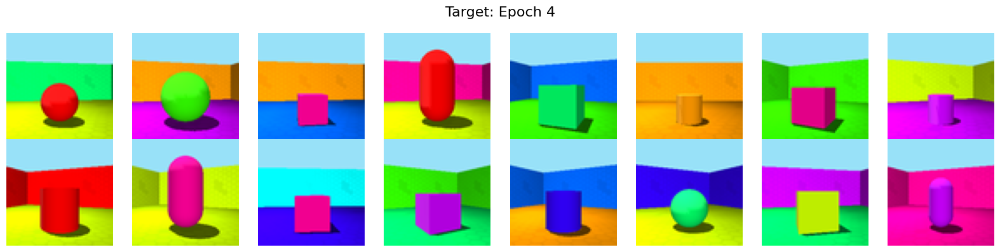

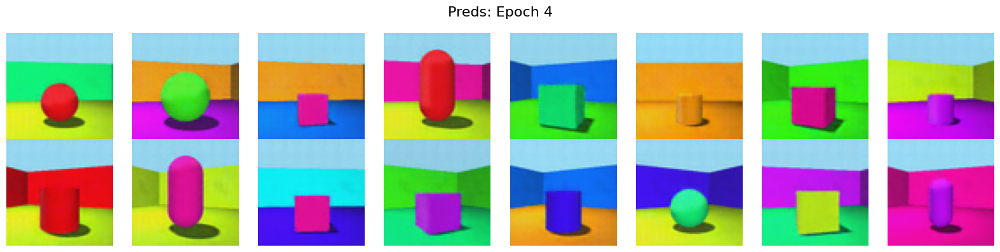

Train Epoch: 5 [0/480000 (0%)]	Loss: 0.000318
Train Epoch: 5 [47872/480000 (10%)]	Loss: 0.000381
Train Epoch: 5 [95744/480000 (20%)]	Loss: 0.000299
Train Epoch: 5 [143616/480000 (30%)]	Loss: 0.000625
Train Epoch: 5 [191488/480000 (40%)]	Loss: 0.000381
Train Epoch: 5 [239360/480000 (50%)]	Loss: 0.000389
Train Epoch: 5 [287232/480000 (60%)]	Loss: 0.000328
Train Epoch: 5 [335104/480000 (70%)]	Loss: 0.000381
Train Epoch: 5 [382976/480000 (80%)]	Loss: 0.000284
Train Epoch: 5 [430848/480000 (90%)]	Loss: 0.000464
Train Epoch: 5 [478720/480000 (100%)]	Loss: 0.000336
====> Epoch: 5 Average loss: 0.0004


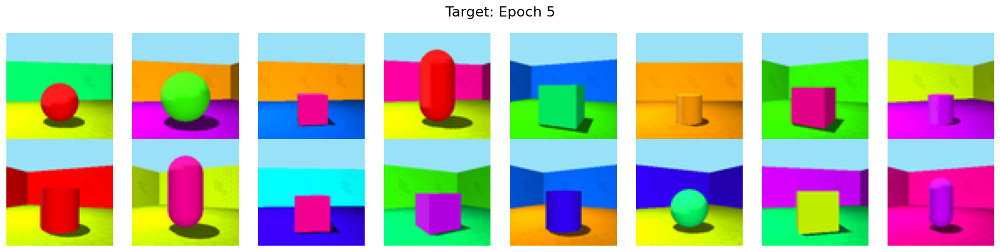

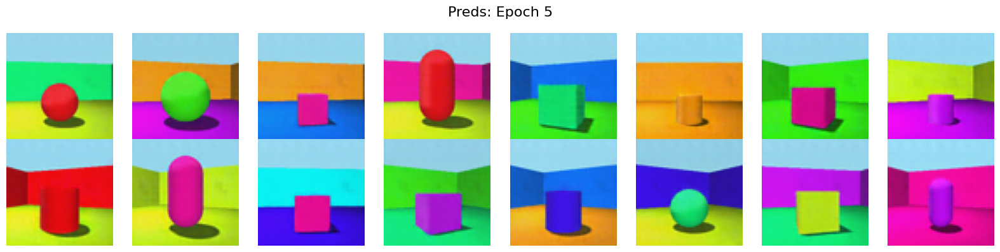

Train Epoch: 6 [0/480000 (0%)]	Loss: 0.000363
Train Epoch: 6 [47872/480000 (10%)]	Loss: 0.000436
Train Epoch: 6 [95744/480000 (20%)]	Loss: 0.000275
Train Epoch: 6 [143616/480000 (30%)]	Loss: 0.000283
Train Epoch: 6 [191488/480000 (40%)]	Loss: 0.000276
Train Epoch: 6 [239360/480000 (50%)]	Loss: 0.000211
Train Epoch: 6 [287232/480000 (60%)]	Loss: 0.000274
Train Epoch: 6 [335104/480000 (70%)]	Loss: 0.000294
Train Epoch: 6 [382976/480000 (80%)]	Loss: 0.000335
Train Epoch: 6 [430848/480000 (90%)]	Loss: 0.000368
Train Epoch: 6 [478720/480000 (100%)]	Loss: 0.000225
====> Epoch: 6 Average loss: 0.0003


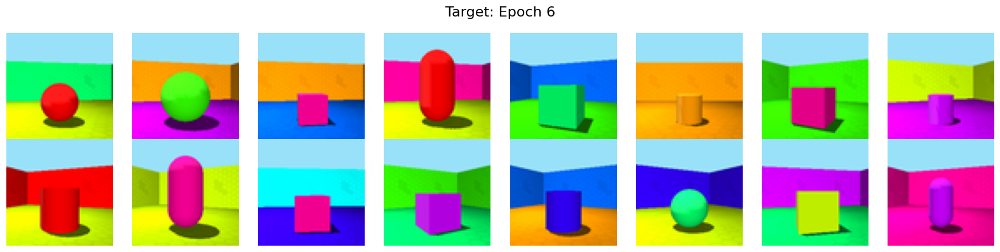

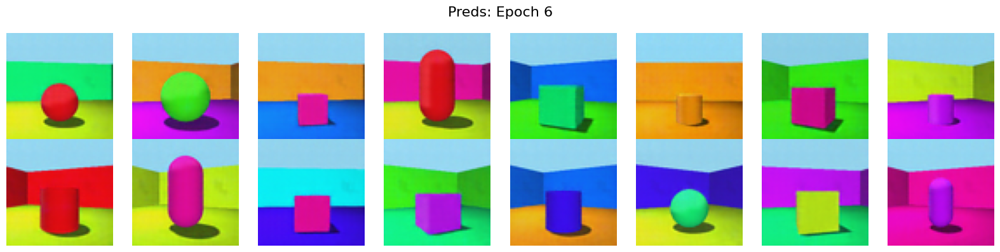

Train Epoch: 7 [0/480000 (0%)]	Loss: 0.000245
Train Epoch: 7 [47872/480000 (10%)]	Loss: 0.000264
Train Epoch: 7 [95744/480000 (20%)]	Loss: 0.000247
Train Epoch: 7 [143616/480000 (30%)]	Loss: 0.000291
Train Epoch: 7 [191488/480000 (40%)]	Loss: 0.000251
Train Epoch: 7 [239360/480000 (50%)]	Loss: 0.000212
Train Epoch: 7 [287232/480000 (60%)]	Loss: 0.000242
Train Epoch: 7 [335104/480000 (70%)]	Loss: 0.000200
Train Epoch: 7 [382976/480000 (80%)]	Loss: 0.000297
Train Epoch: 7 [430848/480000 (90%)]	Loss: 0.000233
Train Epoch: 7 [478720/480000 (100%)]	Loss: 0.000332
====> Epoch: 7 Average loss: 0.0002


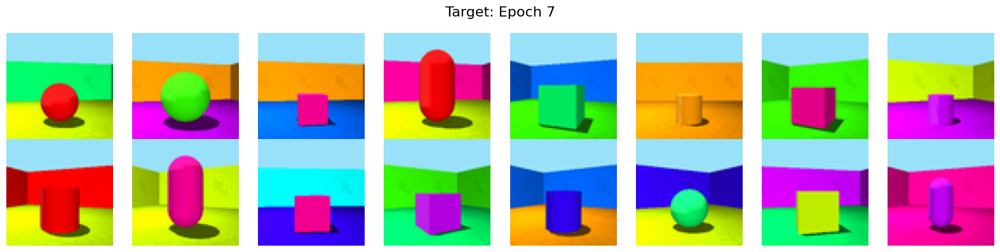

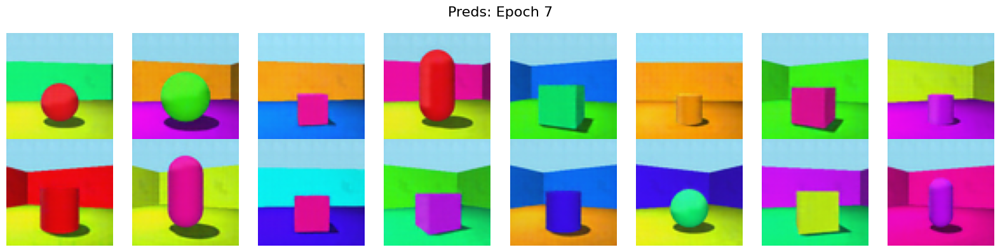

Train Epoch: 8 [0/480000 (0%)]	Loss: 0.000216
Train Epoch: 8 [47872/480000 (10%)]	Loss: 0.000270
Train Epoch: 8 [95744/480000 (20%)]	Loss: 0.000192
Train Epoch: 8 [143616/480000 (30%)]	Loss: 0.000247
Train Epoch: 8 [191488/480000 (40%)]	Loss: 0.000218
Train Epoch: 8 [239360/480000 (50%)]	Loss: 0.000174
Train Epoch: 8 [287232/480000 (60%)]	Loss: 0.000172
Train Epoch: 8 [335104/480000 (70%)]	Loss: 0.000170
Train Epoch: 8 [382976/480000 (80%)]	Loss: 0.000277
Train Epoch: 8 [430848/480000 (90%)]	Loss: 0.000254
Train Epoch: 8 [478720/480000 (100%)]	Loss: 0.000187
====> Epoch: 8 Average loss: 0.0002


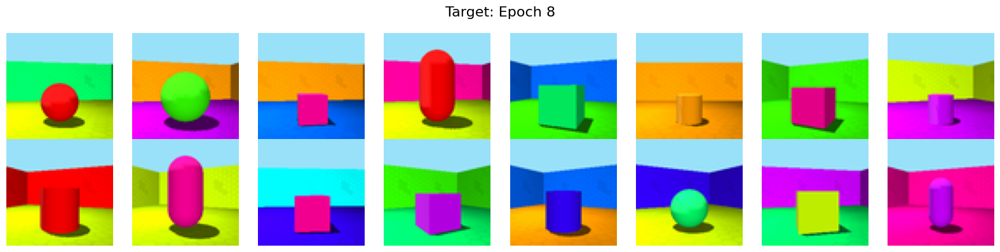

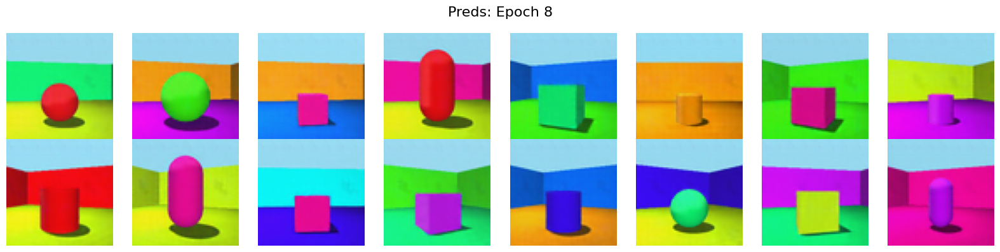

Train Epoch: 9 [0/480000 (0%)]	Loss: 0.000186
Train Epoch: 9 [47872/480000 (10%)]	Loss: 0.000139
Train Epoch: 9 [95744/480000 (20%)]	Loss: 0.000148
Train Epoch: 9 [143616/480000 (30%)]	Loss: 0.000167
Train Epoch: 9 [191488/480000 (40%)]	Loss: 0.000239
Train Epoch: 9 [239360/480000 (50%)]	Loss: 0.000176
Train Epoch: 9 [287232/480000 (60%)]	Loss: 0.000174
Train Epoch: 9 [335104/480000 (70%)]	Loss: 0.000145
Train Epoch: 9 [382976/480000 (80%)]	Loss: 0.000215
Train Epoch: 9 [430848/480000 (90%)]	Loss: 0.000160
Train Epoch: 9 [478720/480000 (100%)]	Loss: 0.000172
====> Epoch: 9 Average loss: 0.0002


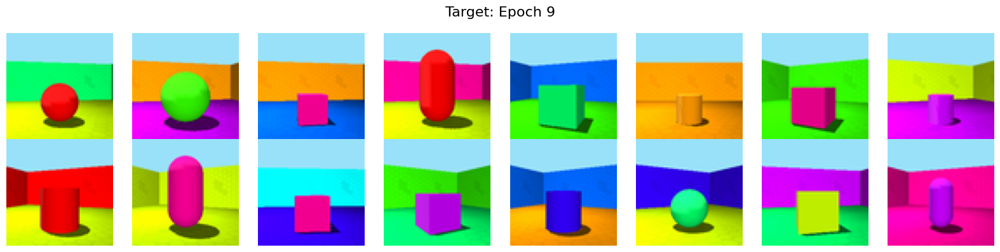

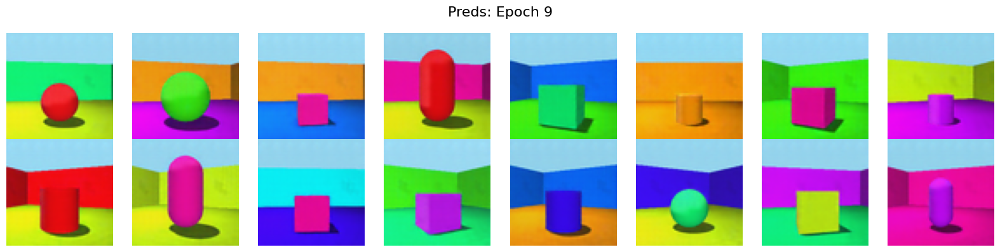

In [29]:
from torch.optim import Adam
device = "cuda"
#d_hidden=128 if from pretrained model, 1024 if from vit_l_32
decoder = BigDecoder(d_hidden=1024, hidden_dims=[64, 128, 256, 512, 1024], out_dim=3, cifar_cross_entropy=False, end_in_sigmoid=False).to(device)
opt = Adam(decoder.parameters(), lr=0.001)

tst_imgs = imgs[tst_indices]
tst_reps = enc_reps[tst_indices]
n_epochs = 10

for epoch in tqdm(range(n_epochs)):
    train_autoencoder_generative(decoder,
                                 decoder_dl,
                                 opt,
                                 device,
                                 epoch,
                                 variational=False,
                                 test_every=0,
                                 test_fn=None,
                                 oracle_input=False,
                                 process_input=None,
                                 kld_weight=0.1,
                                 cross_entropy=False)

    
    pred_imgs = decoder(tst_reps.cuda()).detach().cpu()
    plot_images(tst_imgs, title=f"Target: Epoch {epoch}")
    plot_images(pred_imgs, title=f"Preds: Epoch {epoch}")
# Get reps from trained model for evaluation

# select: cylinder at origin for all latents



In [30]:
#torch.save(decoder.state_dict(), f"results/decoders/{args.dataset}/{exp_id}_decoder.pth")
torch.save(decoder.state_dict(), f"results/decoders/{args.dataset}/full_decoder.pth")

## Evaluation of Modulated Representations

## Modulated Reps

In [47]:

exp_id = "i1h2ptub"
args = get_args(exp_id,update_id=True)
weights=torch.load(f"results/decoders/{args.dataset}/{exp_id}_decoder.pth")
device = "cuda"
decoder = BigDecoder(d_hidden=128, hidden_dims=[64, 128, 256, 512, 1024], out_dim=3, cifar_cross_entropy=False, end_in_sigmoid=False).to(device)
decoder.load_state_dict(weights)
decoder = decoder.to(device)
model = get_model_from_exp(args).to(device)
reps = get_reps_from_model(exp_id)

using pretrained reps...


  0%|          | 0/469 [00:00<?, ?it/s]

In [97]:
print(args.train_method)

rep_train_same_linop


In [48]:
imgs = torch.load(f"{args.dataset}/{args.dataset}.pth")['images']/255.0
if args.pretrained_reps:
    reps_path = args.pretrained_reps
elif args.pretrained_encoder:
    encoder_args = get_args(args.pretrained_encoder)
    reps_path = encoder_args.pretrained_reps
enc_reps= torch.load(f"{args.dataset}/{args.dataset}_images_feats_{reps_path}.pth", map_location="cpu") if reps_path else None
enc_reps = enc_reps - enc_reps.mean(dim=0) # center
enc_reps = torch.nn.functional.normalize(enc_reps, p=2.0, dim=1, eps=1e-12)

In [29]:
import torch
# Values from appendix of https://arxiv.org/pdf/2107.08221 page 24
# indices start at 0:
# Shapes3D extrapolation floor color {8, 9}
# Shapes3D extrapolation wall color {8, 9}
# Shapes3D extrapolation object color {8, 9}
# Shapes3D extrapolation object size {6, 7}
# Shapes3D extrapolation azimuth {12, 13, 14}

head_names = ["floor_hue", "wall_hue", "object_hue", "scale", "shape", "orient"]
def to_idx(latent):
    multiplier = torch.tensor([10*10*8*4*15,10*8*4*15,8*4*15,4*15,15,1])
    return (latent*multiplier).sum()

device="cuda"
def get_mod_reps(model, reps, delta, device="cuda"):
    model.eval()
    with torch.no_grad():
        delta = delta.to(device)
        new_reps = model.modulator(reps, delta)
    return new_reps.cpu()

floor_color_deltas = [[i, 0, 0, 0, 0, 0] for i in range(10)] # only modify scale
wall_color_deltas= [[0, i, 0, 0, 0, 0] for i in range(10)] # only modify scale
object_color_deltas = [[0, 0, i, 0,0, 0] for i in range(10)] # only modify scale
size_deltas = [[0, 0, 0, i, 0, 0] for i in range(8)] # only modify scale
shape_deltas = [[0, 0, 0, 0, i, 0] for i in range(4)] # only modify scale
orientation_deltas = [[0, 0, 0, 0, 0, i] for i in range(15)] # only modify scale

floor_color_deltas = torch.tensor(floor_color_deltas).float()
wall_color_deltas = torch.tensor(wall_color_deltas).float()
object_color_deltas = torch.tensor(object_color_deltas).float()
size_deltas = torch.tensor(size_deltas).float()
shape_deltas = torch.tensor(shape_deltas).float()
orientation_deltas = torch.tensor(orientation_deltas).float()

def get_imgs(model, decoder, b_latent, deltas, imgs, reps, enc_reps, idx=0, caption=""):
    decoder.eval()
    line = [8,8,8,6,None,12]
    deltas = deltas.clone()
    deltas[:,idx] -= b_latent[idx]
    #real_deltas = deltas - base_latent
    n = deltas.shape[0]
    abs_latents = b_latent + deltas
    tgt_indices = sorted([to_idx(latent).item() for latent in abs_latents])
    base_index = to_idx(b_latent)
    auto_reps = reps[tgt_indices] # base autoencoder
    base_reps = enc_reps[base_index].unsqueeze(0)
    base_reps = base_reps.repeat(n, 1) # repeat base representation for every delta
    pred_reps = get_mod_reps(model, base_reps.cuda(), deltas.cuda())
    tgt_imgs = imgs[tgt_indices] # imagen real
    base_imgs = imgs[base_index].unsqueeze(0).repeat(n,1,1,1)
    pred_imgs = decoder(pred_reps.cuda()).detach().cpu()
    auto_imgs = decoder(auto_reps.cuda()).detach().cpu()
    plot_images(tgt_imgs,ncols=n,title=f"Target Images - {caption}",highlight_idx=base_latent[idx],vline_before_idx=line[idx]
                ,save=True
                ,save_name=f"imgs/{head_names[idx]}_targets_ood.png")
    plot_images(auto_imgs,ncols=n,title=f"Decoder Images - {caption}",highlight_idx=base_latent[idx],vline_before_idx=line[idx]
                ,save=True
                ,save_name=f"imgs/{head_names[idx]}_decoder_preds_ood.png")
    plot_images(pred_imgs,ncols=n,title=f"Prediction Images - {caption}",highlight_idx=base_latent[idx],vline_before_idx=line[idx]          
                ,save=True
                ,save_name=f"imgs/{head_names[idx]}_manipulated_preds_ood.png")
    #plot_images(base_imgs,ncols=n,title=f"Starting Images - {caption}",highlight_idx=base_latent[idx],vline_before_idx=line[idx])



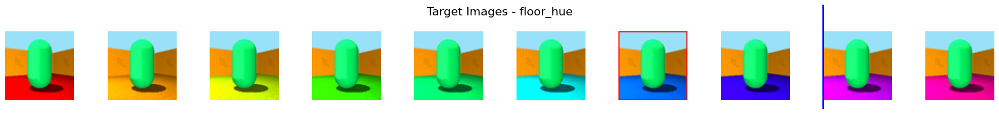

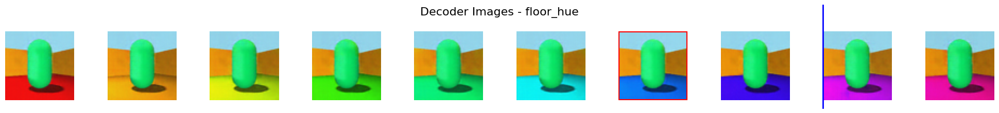

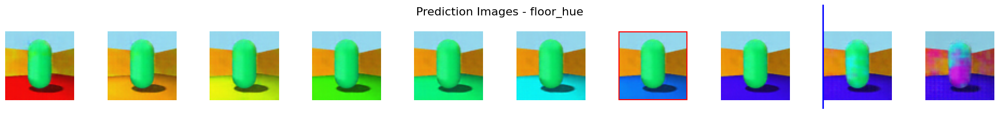

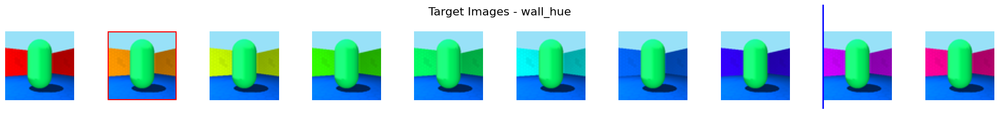

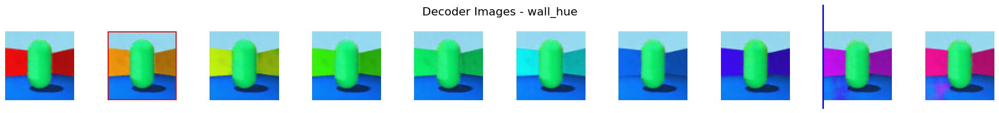

...

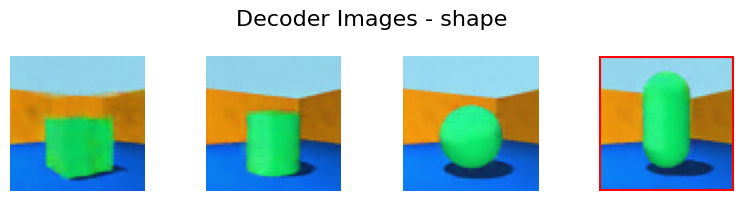

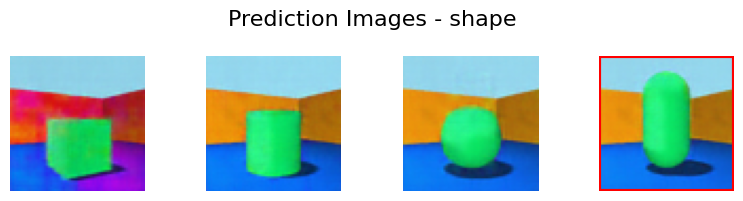

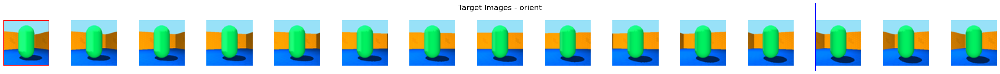

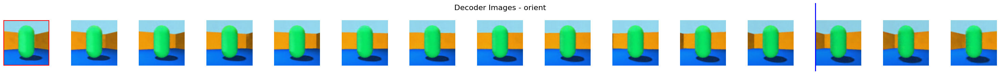

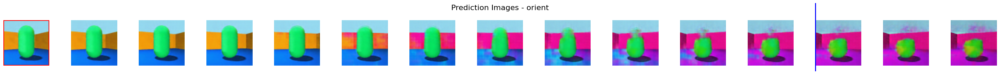

In [32]:
from IPython.display import display, HTML

display(HTML("<style>.output_scroll {height: 1024px; overflow: auto;}</style>"))
base_latent = torch.tensor([6,1,4,7,3,0])

get_imgs(model, decoder, base_latent, floor_color_deltas, imgs, reps, enc_reps,idx=0, caption=head_names[0])
get_imgs(model, decoder, base_latent, wall_color_deltas, imgs, reps, enc_reps,idx=1, caption=head_names[1])
get_imgs(model, decoder, base_latent, object_color_deltas, imgs, reps, enc_reps,idx=2, caption=head_names[2])
get_imgs(model, decoder, base_latent, size_deltas, imgs, reps, enc_reps,idx=3, caption=head_names[3])
get_imgs(model, decoder, base_latent, shape_deltas, imgs, reps, enc_reps,idx=4, caption=head_names[4])
get_imgs(model, decoder, base_latent, orientation_deltas, imgs, reps, enc_reps,idx=5, caption=head_names[5])

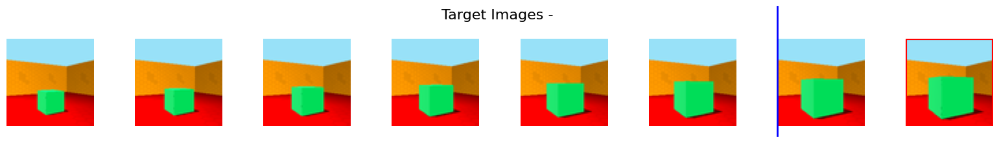

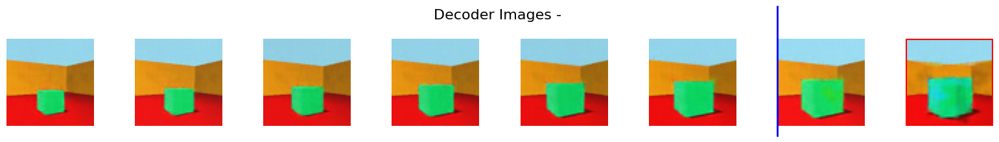

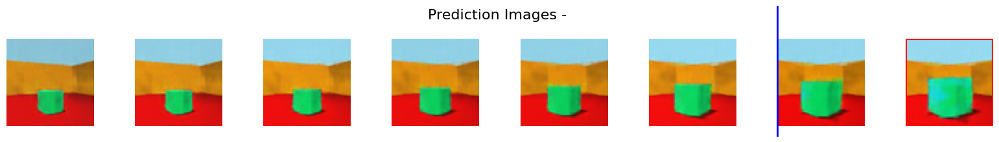

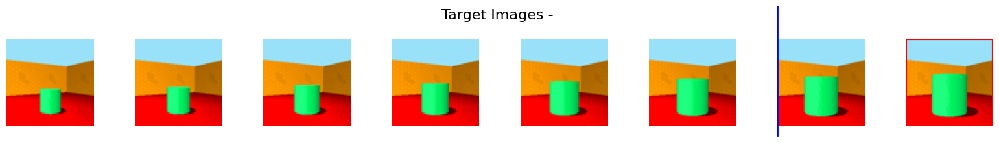

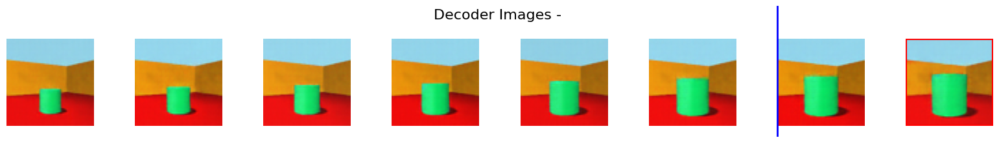

...

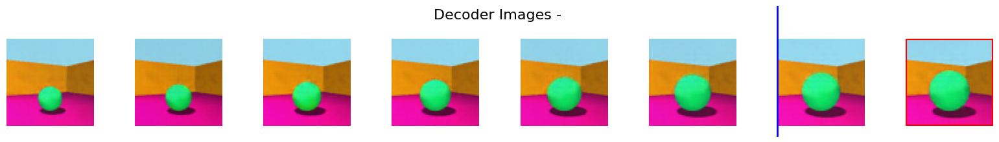

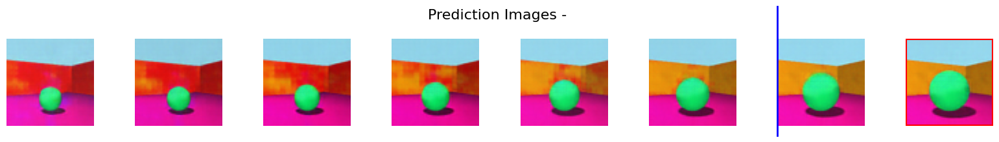

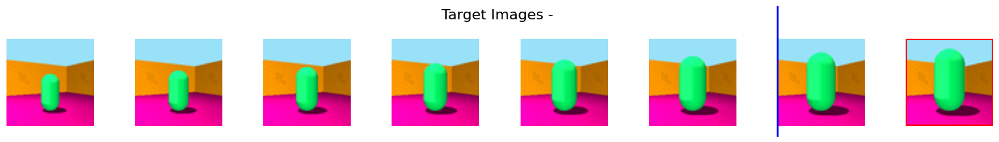

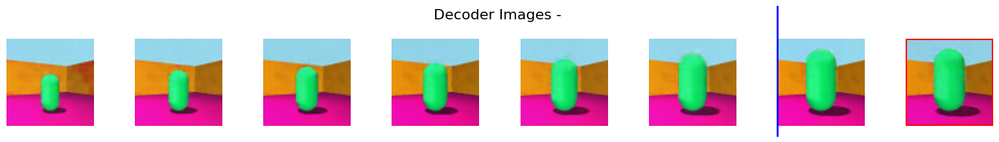

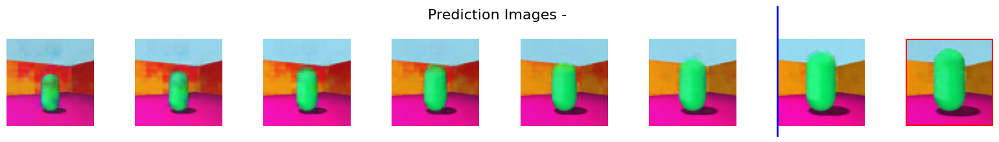

In [28]:
for i in range(10):
    for j in range(4):
        base_latent = torch.tensor([i,1,4,7,j,0])
        get_imgs(model, decoder, base_latent, size_deltas, imgs, reps, enc_reps,idx=3, caption="")

## Entrenamiento Clasificador General

In [31]:
from model_info import BigEncoder, BigDecoder
import torch.nn as nn
from tqdm import tqdm
from torch.optim import Adam
from easydict import EasyDict as edict

def train_batch(model, batch, optimizer, device):
    model.train()
    x, _,  y = batch  # x: images, y: tuple of 6 tensors (B,)
    x = x.float().to(device)
    y = [y[:, i].to(device) for i in range(y.shape[1])]
    outputs = model(x)  # list of logits per head

    # Calculate losses and accuracies per head
    losses = [F.cross_entropy(logits, targets) for logits, targets in zip(outputs, y)]
    preds = [torch.argmax(logits, dim=1) for logits in outputs]
    accuracies = [(pred == target).float().mean().item() for pred, target in zip(preds, y)]

    # Total loss is the sum
    loss = sum(losses)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    return {
        "loss": loss.item(),
        "head_losses": [l.item() for l in losses],
        "head_accuracies": accuracies,
        "overall_accuracy": sum(accuracies) / len(accuracies)
    }


def train_model(model, train_loader, optimizer, device, num_epochs=10):
    model.to(device)

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")
        model.train()

        # Tracking variables
        running_loss = 0.0
        running_accuracies = [0.0] * len(model.output_dims)
        total_batches = 0

        for batch in tqdm(train_loader, desc="Training"):
            metrics = train_batch(model, batch, optimizer, device)

            running_loss += metrics["loss"]
            for i, acc in enumerate(metrics["head_accuracies"]):
                running_accuracies[i] += acc
            total_batches += 1
        # Average training metrics
        avg_loss = running_loss / total_batches
        avg_head_accuracies = [acc / total_batches for acc in running_accuracies]
        avg_overall_accuracy = sum(avg_head_accuracies) / len(avg_head_accuracies)

        print(f"Train Loss: {avg_loss:.4f} | Avg Accuracy per Head: {[f'{a:.3f}' for a in avg_head_accuracies]} | Overall: {avg_overall_accuracy:.3f}")

In [32]:
# Create dataloader
# images and latents!
args = edict()
# Model: Big Encoder + Classification Layer

args.dataset = "3dshapes"
args.pretrained_reps = None
args.pretrained_encoder = None

In [33]:
dl = get_dataloader(args,bs=256,shuffle=True)


using input images


In [8]:
# Create Model
model=BigMultiHeadClassifier()
optimizer = Adam(model.parameters(), lr=0.001)
device = "cuda"

In [9]:
train_model(model, dl, optimizer, device, num_epochs=10)


Epoch 1/10


Training: 100%|██████████| 1875/1875 [00:31<00:00, 59.43it/s]


Train Loss: 0.5074 | Avg Accuracy per Head: ['0.992', '0.995', '0.983', '0.930', '0.975', '0.954'] | Overall: 0.971

Epoch 2/10


Training: 100%|██████████| 1875/1875 [00:32<00:00, 57.52it/s]


Train Loss: 0.0332 | Avg Accuracy per Head: ['0.999', '0.999', '0.998', '0.996', '0.999', '0.999'] | Overall: 0.998

Epoch 3/10


Training: 100%|██████████| 1875/1875 [00:36<00:00, 51.65it/s]


Train Loss: 0.0228 | Avg Accuracy per Head: ['0.999', '0.999', '0.999', '0.997', '0.999', '0.999'] | Overall: 0.999

Epoch 4/10


Training: 100%|██████████| 1875/1875 [00:34<00:00, 54.72it/s]


Train Loss: 0.0207 | Avg Accuracy per Head: ['0.999', '0.999', '0.999', '0.998', '0.999', '0.999'] | Overall: 0.999

Epoch 5/10


Training: 100%|██████████| 1875/1875 [00:36<00:00, 50.88it/s]


Train Loss: 0.0187 | Avg Accuracy per Head: ['0.999', '0.999', '0.999', '0.998', '0.999', '0.999'] | Overall: 0.999

Epoch 6/10


Training: 100%|██████████| 1875/1875 [00:35<00:00, 52.48it/s]


Train Loss: 0.0164 | Avg Accuracy per Head: ['0.999', '1.000', '0.999', '0.998', '0.999', '0.999'] | Overall: 0.999

Epoch 7/10


Training: 100%|██████████| 1875/1875 [00:34<00:00, 54.60it/s]


Train Loss: 0.0160 | Avg Accuracy per Head: ['1.000', '1.000', '0.999', '0.999', '0.999', '0.999'] | Overall: 0.999

Epoch 8/10


Training: 100%|██████████| 1875/1875 [00:34<00:00, 54.35it/s]


Train Loss: 0.0142 | Avg Accuracy per Head: ['1.000', '1.000', '0.999', '0.999', '0.999', '0.999'] | Overall: 0.999

Epoch 9/10


Training: 100%|██████████| 1875/1875 [00:33<00:00, 56.20it/s]


Train Loss: 0.0122 | Avg Accuracy per Head: ['1.000', '1.000', '0.999', '0.999', '1.000', '0.999'] | Overall: 0.999

Epoch 10/10


Training: 100%|██████████| 1875/1875 [00:34<00:00, 53.94it/s]

Train Loss: 0.0128 | Avg Accuracy per Head: ['1.000', '1.000', '0.999', '0.999', '1.000', '0.999'] | Overall: 0.999


In [11]:
torch.save(model.state_dict(), "results/classifiers/3dshapes/full_classifier.pth")

## Evaluación de imágenes generadas via clasificador

In [49]:
# Obtener qué imagenes son ID y cuáles OOD
test_indices = torch.load("3dshapes/3dshapes_extrapolation_test_indices.pth")
indices = torch.zeros(len(imgs))
indices[test_indices] = 1

latents_sizes = torch.tensor([10,10,10,8,4,15])
latents_bases = torch.cat((latents_sizes.flip(0).cumprod(0).flip(0)[1:], torch.tensor([1])))
base_latent = torch.tensor([9, 9, 9, 7, 3, 14])

def latent_to_index(latents):
  return (latents*latents_bases).sum().item()
    
latent_to_index(base_latent)

479999

In [50]:
# Let's load decoder and classifier for evaluation
device="cuda"
classifier = BigMultiHeadClassifier()
weights = torch.load("results/classifiers/3dshapes/full_classifier.pth")
classifier.load_state_dict(weights)
classifier = classifier.to(device)


In [51]:
# Decoder
exp_id = "e99wn9i9"
args = get_args(exp_id, update_id=True)
weights=torch.load(f"results/decoders/{args.dataset}/{exp_id}_decoder.pth")
#exp_id = "e99wn9i9"
#weights=torch.load(f"results/decoders/{args.dataset}/full_decoder.pth")
device = "cuda"
decoder1 = BigDecoder(d_hidden=128, hidden_dims=[64, 128, 256, 512, 1024], out_dim=3, cifar_cross_entropy=False, end_in_sigmoid=False).to(device)
decoder1.load_state_dict(weights)
decoder1= decoder1.to(device)

In [52]:
# Create Dataloder for this
from torch.utils.data import DataLoader, TensorDataset

print("Loading representations from model")
reps = get_reps_from_model(exp_id)
#reps=enc_reps
ds_reps = TensorDataset(reps)
dl_reps = DataLoader(ds_reps, batch_size=1024,shuffle=False)



Loading representations from model
using pretrained reps...


  0%|          | 0/469 [00:00<?, ?it/s]

In [53]:
print("Creating images from representations")
imgs = []
with torch.no_grad():
    decoder1.eval()
    for (img,) in tqdm(dl_reps):
        img = img.to(device)
        imgs.append(decoder1(img).detach().cpu())
    imgs = torch.cat(imgs, dim=0)

latents =  torch.load("3dshapes/3dshapes.pth")['latent_ids']
ds = TensorDataset(imgs, latents)
gen_loader = DataLoader(ds, batch_size=128, shuffle=False)

Creating images from representations


  0%|          | 0/469 [00:00<?, ?it/s]

In [54]:
@torch.no_grad()
def evaluate_generated(model, gen_loader, device):
    model.eval()
    total_loss = 0
    total_correct = [0] * len(model.output_dims)
    total_count = 0

    for n_batch, (x, y) in enumerate(tqdm(gen_loader)):
        x = x.to(device)
        y = [y[:, i].to(device) for i in range(y.shape[1])]

        outputs = model(x)
        losses = [F.cross_entropy(logits, targets, reduction='mean') for logits, targets in zip(outputs, y)]
        preds = [torch.argmax(logits, dim=1) for logits in outputs]
        batch_size = x.size(0)

        for i in range(len(model.output_dims)):
            total_correct[i] += (preds[i] == y[i]).sum().item()

        total_loss += sum(losses).item()
        total_count += batch_size

    accs = [correct / total_count for correct in total_correct]
    return {
        "loss": total_loss / total_count,
        "head_accuracies": accs,
        "overall_accuracy": sum(accs) / len(accs)
    }


evaluate_generated(classifier, gen_loader, device="cuda")

  0%|          | 0/3750 [00:00<?, ?it/s]

{'loss': 0.051270734771449576,
 'head_accuracies': [0.9898458333333333,
  0.9938854166666666,
  0.9789166666666667,
  0.8911979166666667,
  0.9985895833333334,
  0.93618125],
 'overall_accuracy': 0.9647694444444443}

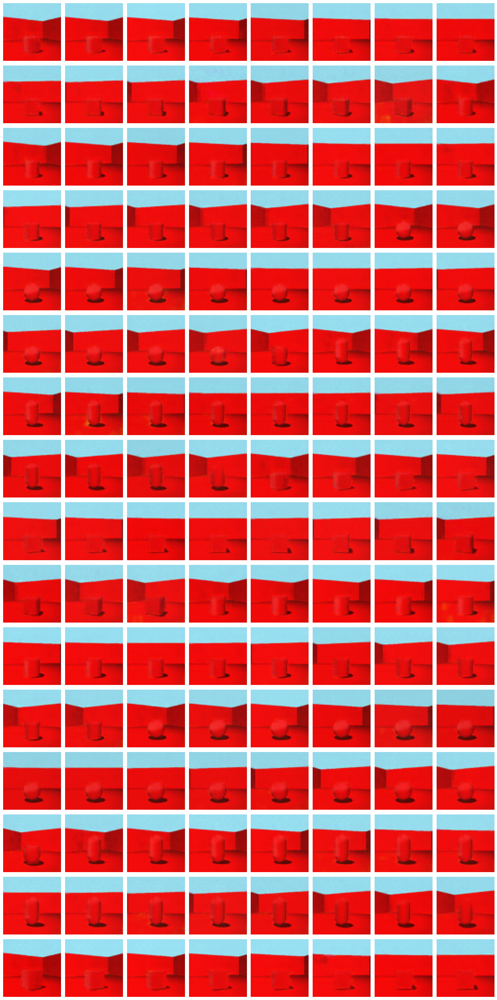

In [107]:
x,y = next(iter(gen_loader)) 
plot_images(x)

In [74]:
from collections import defaultdict
from tqdm import tqdm
import torch.nn.functional as F
import pandas as pd

@torch.no_grad()
def eval_by_delta(model, classifier, decoder, dataloader, device="cuda",idx=0):
    model.eval()
    classifier.eval()
    decoder.eval()

    acc_by_delta = defaultdict(lambda: {"correct": [0]*6, "total": [0]*6})

    for n_batch, (reps, target_latents, deltas) in enumerate(tqdm(dataloader)):
        reps = reps.to(device)
        deltas = deltas.to(device)
        target_latents = target_latents.to(device)

        # Predict representations and decode
        pred_reps = model.modulator(reps, deltas)

        pred_imgs = decoder(pred_reps)

        # Classify predicted images
        logits = classifier(pred_imgs)  # list of 6 (B, num_classes)
        preds = [torch.argmax(logit, dim=1) for logit in logits]

        # Ground-truth labels from target_latents
        targets = [target_latents[:, i] for i in range(6)]

        # Compute |delta|
        #delta_mags = deltas.abs().sum(dim=1).tolist()
        delta_mags = deltas[:, idx].abs().tolist()


        for i in range(len(reps)):
            delta_mag = int(delta_mags[i])
            for j in range(6):  # loop over classification heads
                if preds[j][i].item() == targets[j][i].item():
                    acc_by_delta[delta_mag]["correct"][j] += 1
                acc_by_delta[delta_mag]["total"][j] += 1

    # Aggregate per-head accuracy by delta
    acc_summary = {}
    for delta, stats in sorted(acc_by_delta.items()):
        per_head_acc = [
            stats["correct"][j] / stats["total"][j] if stats["total"][j] > 0 else 0.0
            for j in range(6)
        ]
        acc_summary[delta] = per_head_acc

    # Compute overall accuracy per head
    total_correct = [0] * 6
    total_total = [0] * 6
    for stats in acc_by_delta.values():
        for j in range(6):
            total_correct[j] += stats["correct"][j]
            total_total[j] += stats["total"][j]

    overall_acc = [
        total_correct[j] / total_total[j] if total_total[j] > 0 else 0.0
        for j in range(6)
    ]   
    return acc_summary, overall_acc

@torch.no_grad()
def eval_by_delta(model, classifier, decoder, dataloader, ood, device="cuda", idx=0):
    def latent_to_index(latents):

        return torch.matmul(latents, latents_bases.T).sum(dim=-1).long()
        
    
    model.eval()
    classifier.eval()
    decoder.eval()

    # Accuracy results grouped by delta magnitude and generalization category
    acc_by_delta_and_gen = defaultdict(lambda: {
        "correct": [[0]*6 for _ in range(4)],  # 4 categories x 6 heads
        "total": [[0]*6 for _ in range(4)]
    })

    for n_batch, (reps, target_latents, deltas) in enumerate(tqdm(dataloader)):
        reps = reps.to(device)
        deltas = deltas.to(device)
        target_latents = target_latents.to(device)

        # Predict representations and decode
        pred_reps = model.modulator(reps, deltas)
        pred_imgs = decoder(pred_reps)

        # Classify predicted images
        logits = classifier(pred_imgs)  # list of 6 (B, num_classes)
        preds = [torch.argmax(logit, dim=1) for logit in logits]

        # Ground-truth labels
        targets = [target_latents[:, i] for i in range(6)]

        # Compute delta magnitude
        delta_mags = deltas[:, idx].abs().tolist()

        # Compute generalization category
        for i in range(len(reps)):
            delta_mag = int(delta_mags[i])

            # Get category
            source_idx = latent_to_index((target_latents[i] - deltas[i]))
            target_idx = latent_to_index(target_latents[i])

            source_ood = ood[source_idx].item()
            target_ood = ood[target_idx].item()

            # Category index: 0=iid-iid, 1=iid-ood, 2=ood-iid, 3=ood-ood
            category = int(source_ood * 2 + target_ood)

            for j in range(6):  # classification heads
                if preds[j][i].item() == targets[j][i].item():
                    acc_by_delta_and_gen[delta_mag]["correct"][category][j] += 1
                acc_by_delta_and_gen[delta_mag]["total"][category][j] += 1

    # Aggregate accuracies
    acc_summary = {}
    for delta, stats in sorted(acc_by_delta_and_gen.items()):
        acc_summary[delta] = []
        for category in range(4):
            per_head_acc = [
                stats["correct"][category][j] / stats["total"][category][j]
                if stats["total"][category][j] > 0 else 0.0
                for j in range(6)
            ]
            acc_summary[delta].append(per_head_acc)  # shape: [delta][category][head]

    return acc_summary

import pandas as pd
from collections import defaultdict

@torch.no_grad()
def eval_by_delta(model, classifier, decoder, dataloader, ood, device="cuda", idx=0):
    def latent_to_index(latents):
        return torch.matmul(latents, latents_bases.T).sum(dim=-1).long()

    model.eval()
    classifier.eval()
    decoder.eval()

    acc_by_delta_and_gen = defaultdict(lambda: {
        "correct": [[0]*6 for _ in range(4)],  # 4 categories x 6 heads
        "total": [[0]*6 for _ in range(4)]
    })

    for n_batch, (reps, target_latents, deltas) in enumerate(tqdm(dataloader)):
        reps = reps.to(device)
        deltas = deltas.to(device)
        target_latents = target_latents.to(device)

        pred_reps = model.modulator(reps, deltas)
        pred_imgs = decoder(pred_reps)
        logits = classifier(pred_imgs)  # list of 6 (B, num_classes)
        preds = [torch.argmax(logit, dim=1) for logit in logits]
        targets = [target_latents[:, i] for i in range(6)]
        delta_mags = deltas[:, idx].abs().tolist()

        for i in range(len(reps)):
            delta_mag = int(delta_mags[i])
            source_idx = latent_to_index(target_latents[i] - deltas[i])
            target_idx = latent_to_index(target_latents[i])

            source_ood = ood[source_idx].item()
            target_ood = ood[target_idx].item()
            category = int(source_ood * 2 + target_ood)

            for j in range(6):
                if preds[j][i].item() == targets[j][i].item():
                    acc_by_delta_and_gen[delta_mag]["correct"][category][j] += 1
                acc_by_delta_and_gen[delta_mag]["total"][category][j] += 1

    # Convert to DataFrame
    rows = []
    cat_map = {0: "iid-iid", 1: "iid-ood", 2: "ood-iid", 3: "ood-ood"}

    for delta, stats in acc_by_delta_and_gen.items():
        for category in range(4):
            for head in range(6):
                row = {
                    "delta": delta,
                    "category": cat_map[category],
                    "head": head,
                    "correct": stats["correct"][category][head],
                    "total": stats["total"][category][head],
                }
                rows.append(row)

    df = pd.DataFrame(rows)
    return df


In [76]:
import torch
from functools import partial
from torch.utils.data import DataLoader, TensorDataset
from model_info import BigMultiHeadClassifier
latent_dims = [10, 10, 10, 8, 4, 15]
max_delta = 15  # how far to go from base_latent[i]
from torch.utils.data import Subset
def generate_valid_deltas(base_latent, idx, max_delta=15):
    base_val = int(base_latent[idx])  # ensure it's an integer
    deltas = [torch.zeros(6)]

    for d in range(1, max_delta + 1):
        for sign in [-1, 1]:
            new_val = base_val + sign * d
            if 0 <= new_val < latent_dims[idx]:
                delta = torch.zeros(6)
                delta[idx] = sign * d
                deltas.append(delta)

    return torch.stack(deltas) if deltas else torch.zeros(0, 6)
    
def collate_fn_with_targets(batch, idx=0, max_delta=3):
    images_out = []
    targets_out = []
    deltas_out = []

    for image, base_latent in batch:
        base_latent = base_latent.float()
        deltas = generate_valid_deltas(base_latent, idx, max_delta)

        if deltas.shape[0] == 0:
            continue  # skip if no valid deltas

        for delta in deltas:
            target_latent = base_latent + delta
            images_out.append(image)
            targets_out.append(target_latent)
            deltas_out.append(delta)

    return (
        torch.stack(images_out),
        torch.stack(targets_out),
        torch.stack(deltas_out),
    )

exp_id = "e99wn9i9"
base = torch.tensor([0,1,4,4,3,1])
generate_valid_deltas(base, idx=5)

start = 0
end = start+2560

args = get_args(exp_id, update_id=True)

# Get pretrained representations from ENCODER
if args.pretrained_reps:
    reps_path = args.pretrained_reps
elif args.pretrained_encoder:
    encoder_args = get_args(args.pretrained_encoder)
    reps_path = encoder_args.pretrained_reps
reps= torch.load(f"{args.dataset}/{args.dataset}_images_feats_{reps_path}.pth", map_location="cpu") if reps_path else None
reps = reps - reps.mean(dim=0) # center
reps = torch.nn.functional.normalize(reps, p=2.0, dim=1, eps=1e-12)
latents =  torch.load("3dshapes/3dshapes.pth")['latent_ids']
ds = TensorDataset(reps, latents)
dl = DataLoader(ds, batch_size=128, shuffle=False, collate_fn=partial(collate_fn_with_targets, idx=0, max_delta=15))

In [77]:
indices = indices.to("cuda")
latents_bases = torch.cat((latents_sizes.flip(0).cumprod(0).flip(0)[1:], torch.tensor([1]))).float().to("cuda")
acc_summary = eval_by_delta(model, classifier, decoder, dl, indices, device="cuda")

print(acc_summary)


100%|██████████| 3750/3750 [44:22<00:00,  1.41it/s]

     delta category  head  correct   total
0        0  iid-iid     0   147349  147456
1        0  iid-iid     1   147117  147456
2        0  iid-iid     2   147033  147456
3        0  iid-iid     3   142591  147456
4        0  iid-iid     4   147440  147456
..     ...      ...   ...      ...     ...
235      9  ood-ood     1    27985   59136
236      9  ood-ood     2    19571   59136
237      9  ood-ood     3    25162   59136
238      9  ood-ood     4    52200   59136
239      9  ood-ood     5    28836   59136

[240 rows x 5 columns]


In [90]:
a = acc_summary
modulated_factor = "floor_hue"
a["modulated_factor"] = modulated_factor
a['dataset'] = args.dataset
a['sub_dataset'] = args.sub_dataset
a['method'] = get_name_from_args(args)
a['seed'] = args.seed
a

,delta,category,head,correct,total,modulated_factor,dataset,sub_dataset,method,seed
0,0,iid-iid,0,147349,147456,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
1,0,iid-iid,1,147117,147456,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
2,0,iid-iid,2,147033,147456,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
3,0,iid-iid,3,142591,147456,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
4,0,iid-iid,4,147440,147456,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
...,...,...,...,...,...,...,...,...,...,...
235,9,ood-ood,1,27985,59136,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
236,9,ood-ood,2,19571,59136,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
237,9,ood-ood,3,25162,59136,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333
238,9,ood-ood,4,52200,59136,floor_hue,3dshapes,extrapolation,rep_train_same_linop_vit_l_32_random_un,333


In [95]:
b = a.groupby(["category"]).sum().reset_index()[['category','correct','total']]
b['acc'] = b['correct']/b['total']
b

,category,correct,total,acc
0,iid-iid,6838035,7077888,0.966112
1,iid-ood,1161369,1769472,0.656336
2,ood-iid,1238519,1769472,0.699937
3,ood-ood,14244677,18183168,0.783399


In [113]:
evaluate_generated(classifier, gen_loader, device="cuda")

100%|██████████| 3750/3750 [00:19<00:00, 190.70it/s]


{'loss': 0.051270734750511124,
 'head_accuracies': [0.9898458333333333,
  0.9938854166666666,
  0.9789166666666667,
  0.8911979166666667,
  0.9985895833333334,
  0.93618125],
 'overall_accuracy': 0.9647694444444443}

In [156]:
idx=5
acc_summary, overall_acc = eval_by_delta(model, classifier, decoder, dl, device="cuda")
head_names = ["floor_hue", "wall_hue", "object_hue", "scale", "shape", "orient"]

modulated_factor = head_names[idx]  # idx = modulated dim passed to collate_fn

# Per-delta accuracy
df_delta = pd.DataFrame.from_dict(
    acc_summary, orient="index", columns=head_names
).reset_index().rename(columns={"index": "delta"})
df_delta["modulated_factor"] = modulated_factor

# Overall accuracy
df_overall = pd.DataFrame([overall_acc], columns=head_names)
df_overall["modulated_factor"] = modulated_factor

100%|██████████| 20/20 [00:13<00:00,  1.44it/s]


In [117]:
head_names = ["floor_hue", "wall_hue", "object_hue", "scale", "shape", "orient"]
idx=0
modulated_factor = head_names[idx]  # idx = modulated dim passed to collate_fn

# Per-delta accuracy
df_delta = pd.DataFrame.from_dict(
    acc_summary, orient="index", columns=head_names
).reset_index().rename(columns={"index": "delta"})
df_delta["modulated_factor"] = modulated_factor

# Overall accuracy
df_overall = pd.DataFrame([overall_acc], columns=head_names)
df_overall["modulated_factor"] = modulated_factor

In [118]:
print(df_delta)
print(df_overall)


   delta  floor_hue  wall_hue  object_hue     scale     shape    orient  \
0      0   0.995125  0.995158    0.981569  0.900633  0.998663  0.951229   
1      1   0.761817  0.985088    0.963455  0.883365  0.998414  0.940020   
2      2   0.712932  0.936870    0.889314  0.836388  0.996311  0.906007   
3      3   0.656906  0.869350    0.823310  0.802393  0.995168  0.862253   
4      4   0.601679  0.801182    0.756170  0.774387  0.992290  0.820977   
5      5   0.529285  0.735375    0.687581  0.744027  0.985677  0.776235   
6      6   0.399307  0.683669    0.620938  0.716086  0.977570  0.727031   
7      7   0.253205  0.620795    0.538906  0.676889  0.962163  0.666181   
8      8   0.267448  0.547651    0.423490  0.610448  0.931250  0.604578   
9      9   0.499927  0.467917    0.338281  0.504250  0.880604  0.536323   

  modulated_factor  
0        floor_hue  
1        floor_hue  
2        floor_hue  
3        floor_hue  
4        floor_hue  
5        floor_hue  
6        floor_hue  
7     

## Análisis Resultados distintos deltas

In [1]:
import pandas as pd
from tqdm.notebook import tqdm
from utils import get_args, get_name_from_args
exps = ["i1h2ptub",
        "e99wn9i9",
        "m3jzscq5",
        "13hgsljh",
        "6kgq972p",
        "qr3o8g18",
        "qdxfor8h",
        "04a0vbot",
        "77yl2hw5",
        "gp51jqdv",
        "nbtscppe",
        "hc2fqhgt",
        "jznsk0ar",
        "8c5rpv6v",
        "pz175tk9",
        "5d498fra",
        "l4oni1tw",
        "n4hzo2v3",
        "v7mikgy5",
        "9lzmjl5o",
        "krsr89ws",
        "cke65fnw",
        "1ood6ap0",
        "vur791kp",
        "w22kxe0w",
        "zjn0e0wh",
        "zolzj16o"
           ]

final_result = pd.DataFrame()
for exp_id in tqdm(exps):
    args = get_args(exp_id)
    filename = f"results/{args.dataset}/{exp_id}_acc_detailed_full.csv"
    df= pd.read_csv(filename)
    final_result = pd.concat([final_result, df])

plot_accuracies(final_result)


  0%|          | 0/27 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: 'results/3dshapes/v7mikgy5_acc_detailed_full.csv'

  0%|          | 0/17 [00:00<?, ?it/s]

Index(['method', 'modulated_factor', 'delta', 'floor_hue', 'object_hue',
       'orientation', 'scale', 'shape', 'wall_hue'],
      dtype='object')


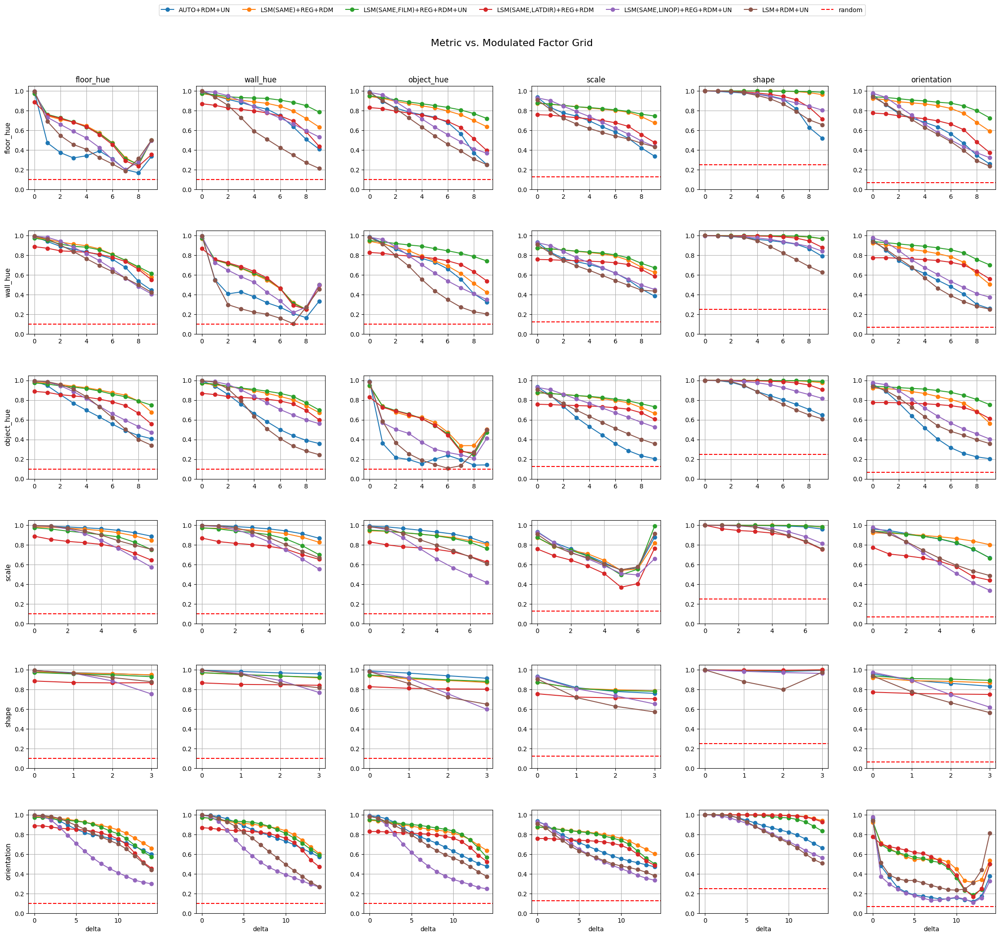

In [4]:
exps = ["i1h2ptub",
        "e99wn9i9",
        "m3jzscq5",
        "13hgsljh",
        "6kgq972p",
        "qr3o8g18",
        "qdxfor8h",
        "04a0vbot",
        "77yl2hw5",
        "gp51jqdv",
        "nbtscppe",
        "hc2fqhgt",
        "jznsk0ar",
        "8c5rpv6v",
        "pz175tk9",
        "5d498fra",
        "l4oni1tw",
        "n4hzo2v3"
       ]
final_result = pd.DataFrame()
for exp_id in tqdm(exps):
    args = get_args(exp_id)
    filename = f"results/{args.dataset}/{exp_id}_acc_detailed_from_reps.csv"
    df= pd.read_csv(filename)
    final_result = pd.concat([final_result, df])

plot_accuracies(final_result)

In [2]:
# Group by 'seed'
df_avg = final_result.groupby([
    'category',
    'modulated_factor',
    "head",
    'dataset',
    'sub_dataset',
    'method'
], as_index=False).sum(numeric_only=True)



In [40]:

task = "orientation"
df = df_avg[(df_avg['modulated_factor'] ==task) & (df_avg['head']==task)]
df['acc'] = df['correct']/df['total']
df = df.pivot_table(
    index=['method'],
    columns='category',
    values=['acc'],
    aggfunc="mean"   # ← Just take the first, don't try to average
)
df

/tmp/ipykernel_278733/3838730648.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['acc'] = df['correct']/df['total']


acc                      \
category                                  iid-iid   iid-ood   ood-iid   
method                                                                  
rep_train_same_linop_vit_l_32_random_un  0.572360  0.001450  0.026920   
rep_train_same_vit_l_32_random           0.903166  0.271893  0.151578   

                                                   
category                                  ood-ood  
method                                             
rep_train_same_linop_vit_l_32_random_un  0.335943  
rep_train_same_vit_l_32_random           0.515117

In [27]:
# Por categoria
df = final_result[final_result['modulated_factor'=="shape"]]
df_avg = final_result.groupby([
    "category",
    'dataset',
    'sub_dataset',
    'method'
], as_index=False).sum()
df_avg['acc'] = df_avg['correct']/df_avg['total']
df = df_avg.pivot_table(
    index=['method'],
    columns='category',
    values=['acc'],
    aggfunc="mean"   # ← Just take the first, don't try to average
)
df

acc                      \
category                                  iid-iid   iid-ood   ood-iid   
method                                                                  
rep_train_same_linop_vit_l_32_random_un  0.941858  0.740860  0.705643   
rep_train_same_vit_l_32_random           0.957215  0.797647  0.730425   

                                                   
category                                  ood-ood  
method                                             
rep_train_same_linop_vit_l_32_random_un  0.797226  
rep_train_same_vit_l_32_random           0.764335

In [3]:
# Por categoria + delta
df_avg = final_result.groupby([
    "category",
    'delta',
    'modulated_factor',
    'dataset',
    'sub_dataset',
    'method'
], as_index=False).sum()
df_avg['acc'] = df_avg['correct']/df_avg['total']
df = df_avg.pivot_table(
    index=['category','method'],
    columns='delta',
    values=['acc'],
    aggfunc="mean"   # ← Just take the first, don't try to average
)

df

acc            \
delta                                                   0         1    
category method                                                        
iid-iid  auto_vit_l_32_random_un                  0.994677  0.950794   
         rep_train_same_film_vit_l_32_random_un   0.975096  0.972980   
         rep_train_same_latdir_vit_l_32_random    0.920586  0.923793   
         rep_train_same_linop_vit_l_32_random_un  0.990159  0.977274   
         rep_train_same_vit_l_32_random           0.962185  0.961009   
         rep_train_vit_l_32_random_un             0.975045  0.942893   
iid-ood  auto_vit_l_32_random_un                       NaN  0.833068   
         rep_train_same_film_vit_l_32_random_un        NaN  0.784112   
         rep_train_same_latdir_vit_l_32_random         NaN  0.739799   
         rep_train_same_linop_vit_l_32_random_un       NaN  0.829655   
         rep_train_same_vit_l_32_random                NaN  0.817892   
         rep_train_vit_l_32_random_un                  NaN  0.822538   
ood-iid  auto_vit_l_32_random_un                       NaN  0.825401   
         rep_train_same_film_vit_l_32_random_un        NaN  0.785922   
         rep_train_same_latdir_vit_l_32_random         NaN  0.745235   
         rep_train_same_linop_vit_l_32_random_un       NaN  0.824996   
         rep_train_same_vit_l_32_random                NaN  0.756493   
         rep_train_vit_l_32_random_un                  NaN  0.803088   
ood-ood  auto_vit_l_32_random_un                  0.962658  0.870525   
         rep_train_same_film_vit_l_32_random_un   0.876118  0.837657   
         rep_train_same_latdir_vit_l_32_random    0.767261  0.747022   
         rep_train_same_linop_vit_l_32_random_un  0.954436  0.895828   
         rep_train_same_vit_l_32_random           0.838723  0.804248   
         rep_train_vit_l_32_random_un             0.943619  0.865179   

                                                                      \
delta                                                   2         3    
category method                                                        
iid-iid  auto_vit_l_32_random_un                  0.924648  0.909453   
         rep_train_same_film_vit_l_32_random_un   0.969603  0.964681   
         rep_train_same_latdir_vit_l_32_random    0.921811  0.919651   
         rep_train_same_linop_vit_l_32_random_un  0.966008  0.948165   
         rep_train_same_vit_l_32_random           0.958567  0.955801   
         rep_train_vit_l_32_random_un             0.892522  0.848422   
iid-ood  auto_vit_l_32_random_un                  0.819144  0.785741   
         rep_train_same_film_vit_l_32_random_un   0.767042  0.762465   
         rep_train_same_latdir_vit_l_32_random    0.732339  0.731711   
         rep_train_same_linop_vit_l_32_random_un  0.813930  0.797127   
         rep_train_same_vit_l_32_random           0.797107  0.796700   
         rep_train_vit_l_32_random_un             0.811360  0.773049   
ood-iid  auto_vit_l_32_random_un                  0.795857  0.767613   
         rep_train_same_film_vit_l_32_random_un   0.774055  0.764159   
         rep_train_same_latdir_vit_l_32_random    0.723421  0.710498   
         rep_train_same_linop_vit_l_32_random_un  0.803357  0.778319   
         rep_train_same_vit_l_32_random           0.733897  0.719804   
         rep_train_vit_l_32_random_un             0.775249  0.744833   
ood-ood  auto_vit_l_32_random_un                  0.828375  0.796426   
         rep_train_same_film_vit_l_32_random_un   0.818828  0.801964   
         rep_train_same_latdir_vit_l_32_random    0.736013  0.726129   
         rep_train_same_linop_vit_l_32_random_un  0.857201  0.810680   
         rep_train_same_vit_l_32_random           0.788285  0.771880   
         rep_train_vit_l_32_random_un             0.807071  0.760002   

                                                                      \
delta                                                   4         5    
category method      

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd


def plot_accuracies(final_result):
    # Ensure metrics are sorted consistently
    metrics = ["floor_hue", "wall_hue", "object_hue", "scale", "shape", "orientation"]
    names = {  'rep_train_vit_l_32_random_un': "LSM+RDM+UN",
               'mod_regression_latdir_vit_l_32_random': "MODREG(LATDIR)+RDM",
               'rep_train_same_linop_vit_l_32_random': "LSM(SAME,LINOP)+REG+RDM",
               'rep_train_same_linop_vit_l_32_random_un': "LSM(SAME,LINOP)+REG+RDM+UN",
               'rep_train_same_latdir_vit_l_32_random': "LSM(SAME,LATDIR)+REG+RDM",
               'mod_regression_linop_vit_l_32_random':  "MODREG(LINOP)+RDM",
               'mod_regression_linop_vit_l_32_random_un':  "MODREG(LINOP)+RDM+UN",
               'mod_regression_vit_l_32': "MODREG",
               "mod_regression_mod_regressioncnn_random":"CNN-MODREG+RDM",
               'mod_regression_vit_l_32_random': "MODREG+RDM" ,
               'non_mod_regression_vit_l_32': "NON-MODREG+RDM", 
               'regressioncnn': "CNN-REG (BASELINE)",
               'rep_train_plus_vit_l_32': "LSM(CLASS)+REG",
               'rep_train_plus_vit_b_32': "LSM(CLASS)+REG (b32)",
               'rep_train_plus_vit_l_32_random': "LSM(CLASS)+REG+RDM",
               'rep_train_same_res_vit_l_32': "LSM(SAME,RES)+REG",  
               'rep_train_same_res_vit_l_32_random': "LSM(SAME,RES)+REG+RDM",
               'rep_train_same_vit_l_32':"LSM(SAME)+REG",  
               'rep_train_same_vit_l_32_random': "LSM(SAME)+REG+RDM",
               'rep_train_same_rep_train_samecnn_random': "CNN-LSM(SAME)+REG+RDM",
               'vit_l_32': "REG (BASELINE)",
               'mod_regression_vit_b_32': "MODREG",
               'non_mod_regression_vit_b_32': "NON-MODREG",
               "rep_train_same_trans_vit_l_32_random": "LSM(SAME,TRANS)+REG+RDM",
               "rep_train_same_film_vit_l_32_random": "LSM(SAME,FILM)+REG+RDM",
               "rep_train_same_film_vit_l_32_random_un": "LSM(SAME,FILM)+REG+RDM+UN",
               "mod_regression_trans_vit_l_32_random": "MODREG(TRANS)+RDM",
               "mod_regression_film_vit_l_32_random": "MODREG(FILM)+RDM",
               "mod_regression_film_vit_l_32_random_un": "MODREG(FILM)+RDM+UN",
               "auto_vit_l_32_random_un": "AUTO+RDM+UN"
            }
    
    random_baselines = {
        "floor_hue": 1/10,
        "wall_hue": 1/10,
        "object_hue": 1/10,
        "scale": 1/8,
        "shape": 1/4,
        "orientation": 1/15,
    }
    
    df_clean = final_result.drop(columns=["Unnamed: 0", "seed"])
    df_clean['method'] = df_clean['method'].apply(lambda x: names[x])
    df_avg = df_clean.groupby(
        ["delta", "modulated_factor", "dataset", "sub_dataset", "method","head"],
        as_index=False
    ).sum()
    df_avg['acc'] = df_avg['correct']/df_avg['total']
    
    df_avg = df_avg.pivot_table(
        index=['method','modulated_factor',"delta"],
        columns='head',
        values=['acc'],
        aggfunc="mean"   # ← Just take the first, don't try to average
    ).reset_index()
    df_avg.columns = ['_'.join(col).strip('_') for col in df_avg.columns.values]
    df_avg.columns = [col.replace("acc_","") for col in df_avg.columns.values]
    print(df_avg.columns)
    n_rows = len(metrics)
    n_cols = len(metrics)
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(4 * n_cols, 3.5 * n_rows), sharex=False, sharey="col")
    
    for i, mod_factor in enumerate(metrics):  # Rows
        for j, metric in enumerate(metrics):  # Columns
            ax = axes[i, j]
    
            df_factor = df_avg[df_avg["modulated_factor"] == mod_factor]
    
            for method, method_df in df_factor.groupby("method"):
                ax.plot(method_df["delta"], method_df[metric], marker='o', label=method)
    
            ax.axhline(random_baselines[metric], color='red', linestyle='--', label='random')
    
            if i == 0:
                ax.set_title(metric, fontsize=12)
            if j == 0:
                ax.set_ylabel(mod_factor, fontsize=11)
            if i == n_rows - 1:
                ax.set_xlabel("delta")
    
            ax.grid(True)
            ax.set_ylim(0, 1.05)
    
    # Get legend from last axis
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=len(labels), bbox_to_anchor=(0.5, 1.02))
    
    # Adjust spacing manually
    fig.subplots_adjust(
        top=0.93, bottom=0.05, left=0.05, right=0.95, hspace=0.4, wspace=0.3
    )
    
    # Add legend and title
    fig.suptitle("Metric vs. Modulated Factor Grid", fontsize=16)
    
    # Save with a large DPI and tight bounding box
    fig.savefig("metric_grid_plot.png", dpi=300, bbox_inches='tight')
    
    # Finally, show
    plt.show()
